In [58]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams['font.family']='serif'
import seaborn as sea
from tqdm import tqdm
import os
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.nn.functional as F
import torchvision
from sklearn.model_selection import train_test_split
import math
from main import Decoder,Encoder
from PIL import Image

In [59]:
image_path_list=[]
for father in os.listdir('input/PetImages'):
    path1='input/PetImages/'
    if '.' not in father:
        for son in os.listdir(path1+father):
            if 'jpg' in son:
                if son!='666.jpg' and son!='11702.jpg':
                    image_path_list.append(path1+father+'/'+son)
train,test=train_test_split(image_path_list,test_size=0.2,random_state=42,shuffle=True)

np.save('input/PetImages/path_train.npy',train)
np.save('input/PetImages/path_test.npy',test)

print('save')

save


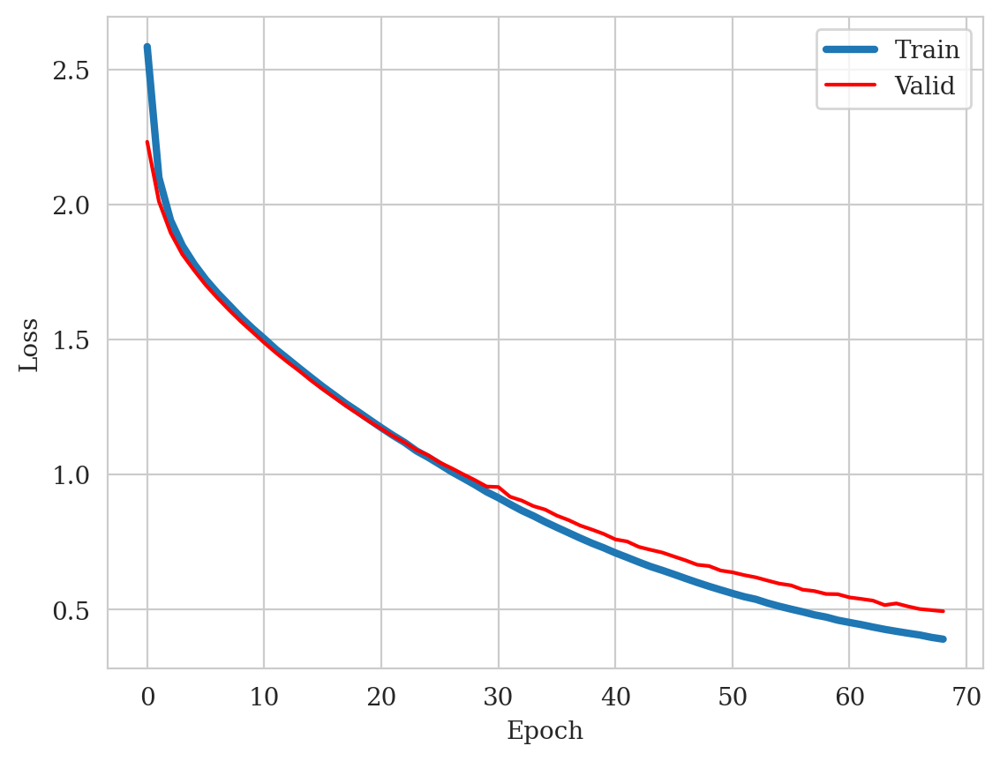

In [60]:
train_loss_list=np.loadtxt('output/train_loss.txt')
test_loss_list=np.loadtxt('output/valid_loss.txt')

plt.figure(dpi=200)
plt.plot(train_loss_list,lw=3,label='Train')
plt.plot(test_loss_list,c='r',label='Valid')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.savefig('output/loss.jpg')

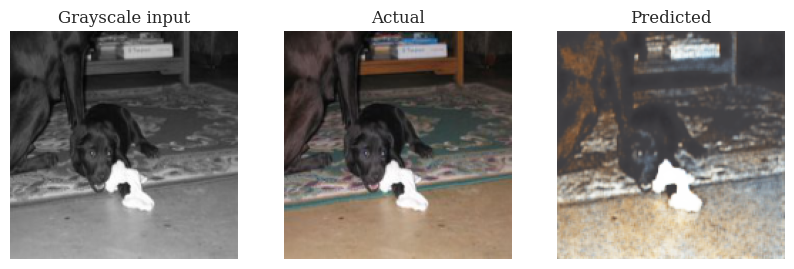

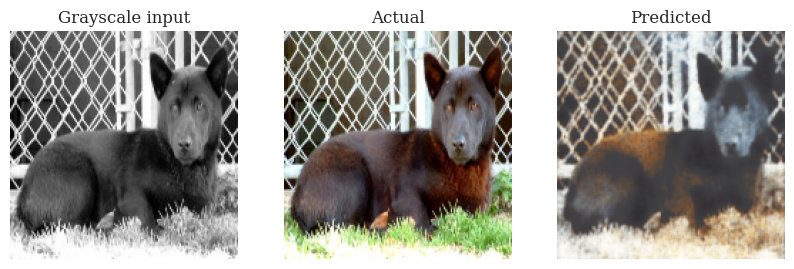

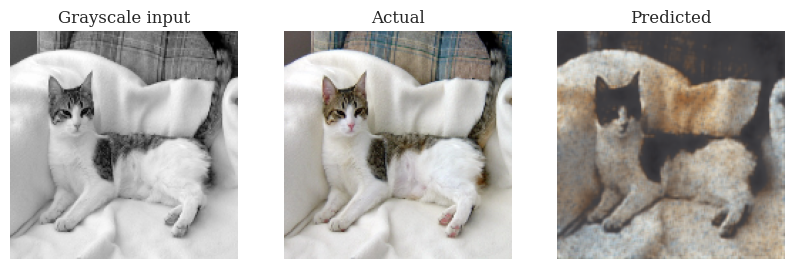

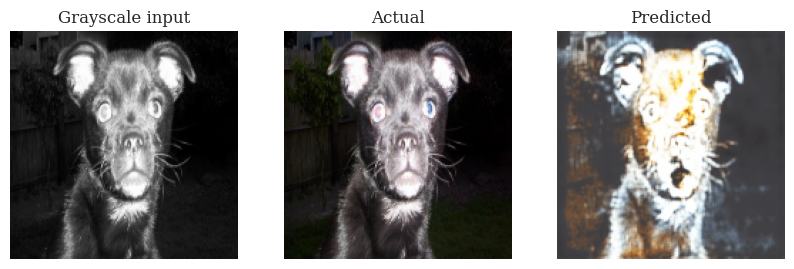

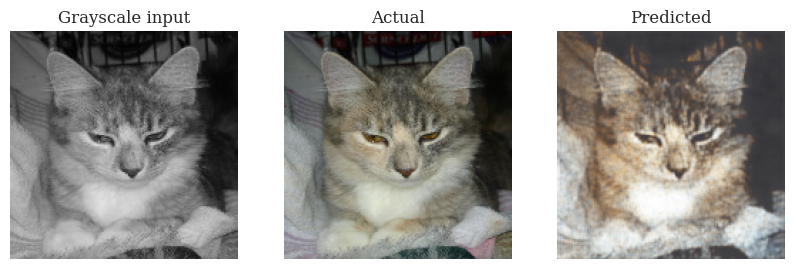

...

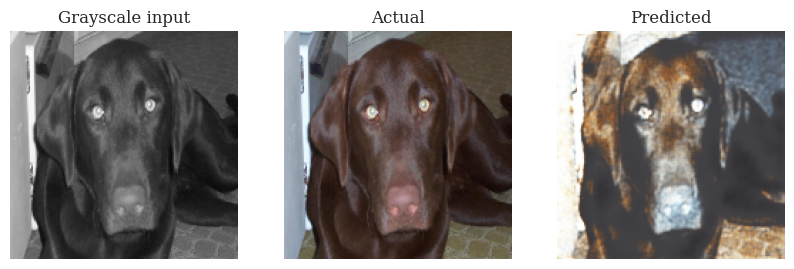

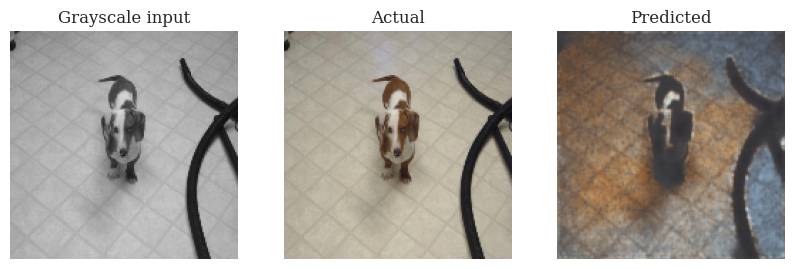

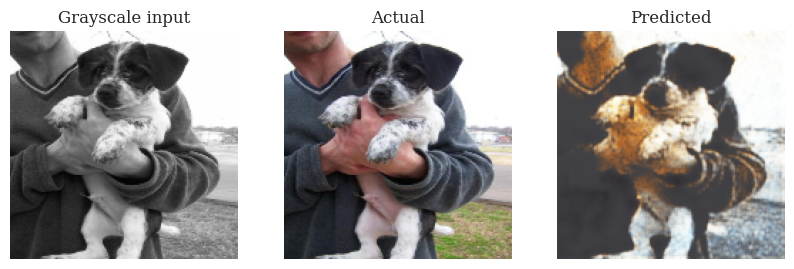

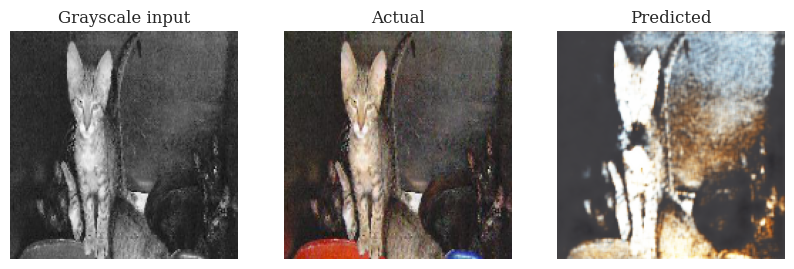

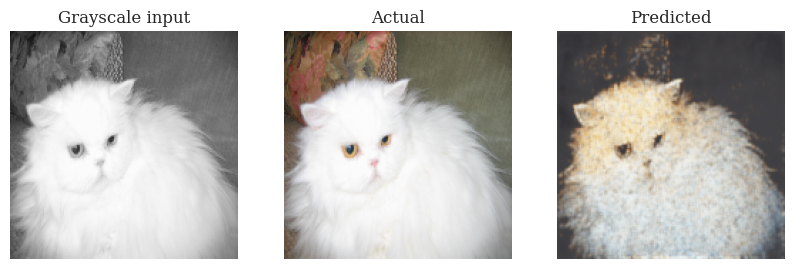

In [62]:
#test result
encoder=Encoder(do_bn=True)
decoder=Decoder(do_bn=True)
encoder.load_state_dict(torch.load('output/encoder.pt',map_location='cpu'))
decoder.load_state_dict(torch.load('output/decoder.pt',map_location='cpu'))

val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize((160, 160)),
        transforms.Normalize(mean=0, std=1),

    ])
gray_transform=transforms.Grayscale(3)

for i in range(100):
    image=Image.open(train[i]).convert('RGB')
    x_input=val_transform(image).view(-1,3,160,160)
    x_gray=gray_transform(x_input).detach().numpy()[0].transpose((1,2,0))
    x_encoded=encoder(x_input)
    x_decoded=decoder(x_encoded)
    image_pred=x_decoded[0].detach().numpy().transpose((1,2,0))


    plt.figure(figsize = (10, 5))
    plt.subplot(1,3,1)
    plt.title('Grayscale input')
    plt.imshow(x_gray)
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title('Actual')
    plt.imshow(val_transform(image).detach().numpy().transpose((1,2,0)))
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title('Predicted')
    plt.imshow(image_pred)
    plt.axis('off')
    plt.savefig(f'output/pred_image{i}')
    plt.show()




